# Ансамбли моделей машинного обучения. Часть 1.

## Подготовка

Загрузка датасета

In [1]:
import pandas as pd
df = pd.read_csv('GM_players_statistics.csv')

In [2]:
df.dtypes

ID                             int64
name                          object
username                      object
profile                       object
user_id                        int64
title                         object
fide                         float64
country                       object
followers                      int64
joined                        object
last_online                   object
current_rapid_rating         float64
highest_rapid_rating         float64
highest_rapid_date            object
rapid_win                    float64
rapid_draw                   float64
rapid_loss                   float64
current_blitz_rating         float64
highest_blitz_rating         float64
highest_blitz_date            object
blitz_win                    float64
blitz_draw                   float64
blitz_loss                   float64
current_bullet_rating        float64
highest_bullet_rating        float64
highest_bullet_date           object
bullet_win                   float64
b

In [3]:
df.head()

,ID,name,username,profile,user_id,title,fide,country,followers,joined,...,highest_bullet_date,bullet_win,bullet_draw,bullet_loss,highest_tactics_rating,highest_tactics_date,highest_puzzle_rush_score,is_streamer,status,league
0,0,Komodo Engine,komodochess,https://www.chess.com/member/KomodoChess,24944922,GM,3411.0,United States,494,07/11/2015,...,NaN,NaN,NaN,NaN,400,07/11/2015,NaN,False,premium,NaN
1,1,Vojtěch Plát,vojtechplat,https://www.chess.com/member/VojtechPlat,37712368,GM,2950.0,Czech Republic,360,11/08/2017,...,27/09/2021,32.0,8.0,47.0,3251,15/09/2021,49.0,False,premium,Bronze
2,2,PlayMagnus Carlsen,playmagnus,https://www.chess.com/member/PlayMagnus,19578862,GM,2882.0,Norway,199,05/11/2014,...,NaN,NaN,NaN,NaN,400,05/11/2014,NaN,False,premium,NaN
3,3,Magnus Carlsen,magnuscarlsen,https://www.chess.com/member/MagnusCarlsen,3889224,GM,2882.0,Norway,142482,27/08/2010,...,28/03/2023,662.0,98.0,246.0,400,27/08/2010,NaN,False,premium,Elite
4,4,Fabiano Caruana,fabianocaruana,https://www.chess.com/member/FabianoCaruana,11177810,GM,2835.0,United States,14445,17/03/2013,...,30/11/2021,713.0,65.0,203.0,3519,14/06/2023,64.0,False,premium,Crystal


Заполнение пропусков

In [4]:
from sklearn.impute import SimpleImputer

num_cols = []

for col in df.columns:
    temp_null_count = df[df[col].isnull()].shape[0]
    dt = str(df[col].dtype)
    if temp_null_count == 0:
        continue

    imp_strategy=''
    if dt=='float64' or dt=='int64':
        num_cols.append(col)
        imp_strategy = 'mean'
    else:
        imp_strategy = 'most_frequent'

    imp_num = SimpleImputer(strategy=imp_strategy)
    data_num_imp = imp_num.fit_transform(df[[col]])
    df[[col]] = data_num_imp

Матрица корреляций

<Axes: >

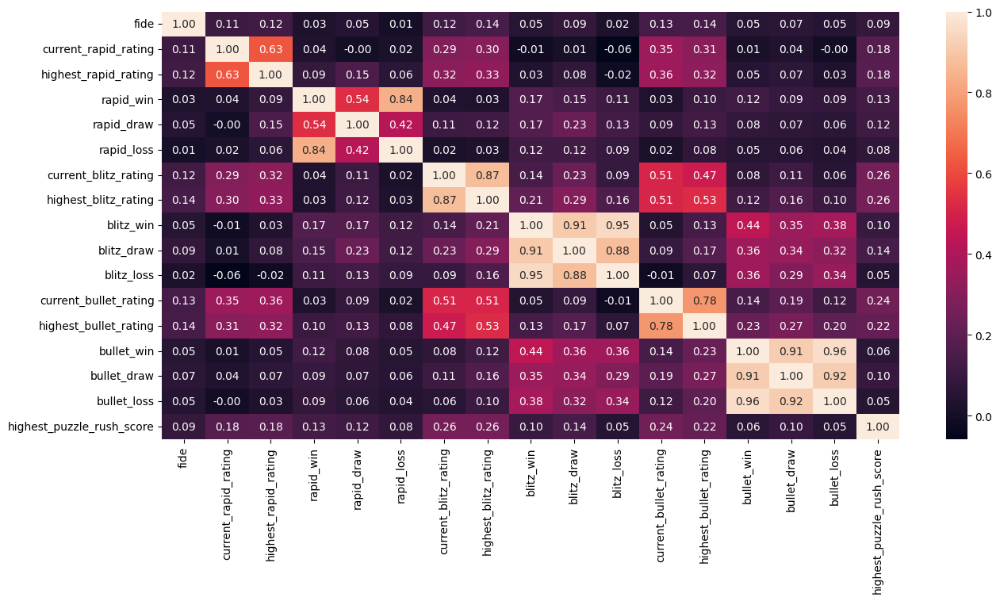

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, ax = plt.subplots(figsize=(15, 7))
sns.heatmap(df[num_cols].corr(method='pearson'), ax=ax, annot=True, fmt='.2f')

Кодирование категориального признака `league`

In [6]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

cat_enc_le = le.fit_transform(df['league'])
df['league_coded'] = cat_enc_le

## Разделение выборки на обучающую и тестовую

In [7]:
from sklearn.model_selection import train_test_split

x_df = df[num_cols] # числовые колонки

y_df = df['league_coded'] # колонка с закодированной лигой

x_train, x_test, y_train, y_test = train_test_split(x_df, y_df, test_size=0.25, random_state=42)

## Бэггинг

In [8]:
from sklearn.ensemble import BaggingClassifier

bc = BaggingClassifier(n_estimators=5, oob_score=True, random_state=42)
bc.fit(x_train, y_train)

C:\Users\Dmitriy\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_bagging.py:789: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
C:\Users\Dmitriy\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_bagging.py:795: RuntimeWarning: invalid value encountered in divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]


BaggingClassifier(n_estimators=5, oob_score=True, random_state=42)

In [10]:
bc.estimators_samples_

[array([ 475, 1065,  970, ...,  152,  869,  201]),
 array([ 686,  663, 1011, ...,  439,  495,  207]),
 array([430, 800, 231, ..., 740,  37, 514]),
 array([800, 581,  63, ..., 610, 894, 408]),
 array([ 350,   25,  235, ...,  127,  843, 1059])]

In [13]:
import numpy as np

# Сконвертируем эти данные в двоичную матрицу, 
# 1 соответствует элементам, попавшим в обучающую выборку
bin_array = np.zeros((5, x_train.shape[0]))
for i in range(5):
    for j in bc.estimators_samples_[i]:
        bin_array[i][j] = 1
bin_array

array([[1., 1., 0., ..., 0., 1., 0.],
       [1., 1., 0., ..., 1., 1., 1.],
       [1., 1., 0., ..., 0., 0., 1.],
       [1., 0., 0., ..., 1., 1., 1.],
       [1., 1., 1., ..., 0., 0., 1.]])

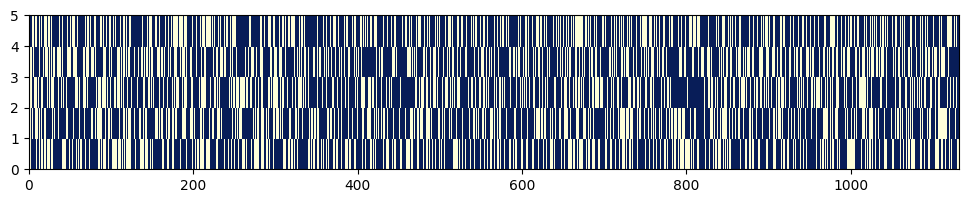

In [14]:
# И визуализируем (синим цветом показаны данные, которые попали в обучающую выборку)
fig, ax = plt.subplots(figsize=(12,2))
ax.pcolor(bin_array, cmap='YlGnBu')
plt.show()

In [15]:
# Оценим Out-of-bag error, теоретическое значение 37%
for i in range(5):
    cur_data = bin_array[i]
    len_cur_data = len(cur_data)
    sum_cur_data = sum(cur_data)
    (len(bin_array[0]) - sum(bin_array[0])) / len(bin_array[0])
    oob_i = (len_cur_data - sum_cur_data) / len_cur_data
    print('Для модели № {} размер OOB составляет {}%'.format(i+1, round(oob_i, 4)*100.0))

Для модели № 1 размер OOB составляет 36.34%
Для модели № 2 размер OOB составляет 36.25%
Для модели № 3 размер OOB составляет 36.34%
Для модели № 4 размер OOB составляет 37.14%
Для модели № 5 размер OOB составляет 37.669999999999995%


In [16]:
# Out-of-bag error, возвращаемый классификатором
# Для классификации используется метрика accuracy
bc.oob_score_, 1-bc.oob_score_

(0.2864721485411141, 0.7135278514588859)

In [17]:
# Параметр oob_decision_function_ возвращает вероятности 
# принадлежности объекта к классам на основе oob
# В данном примере три класса, 
# значения nan могут возвращаться в случае маленькой выборки
bc.oob_decision_function_[55:70]

array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.66666667, 0.        , 0.33333333],
       [0.        , 0.        , 0.5       , 0.        , 0.        ,
        0.5       , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.5       , 0.        ,
        0.5       , 0.        , 0.        ],
       [0.33333333, 0.        , 0.33333333, 0.33333333, 0.        ,
        0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 1.        ,
        0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.5       , 0.5       , 0.        ,
        0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ,
        1.        , 0.        , 0.        ],
       [0.5       , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.5       , 0.        ],
       [0.        , 0.        , 0.        , 1.        , 0.        ,
        0.        , 0.      

In [31]:
from sklearn.tree import export_graphviz
from io import StringIO
import pydotplus

# Визуализация дерева
def get_png_tree(tree_model_param, feature_names_param):
    dot_data = StringIO()
    export_graphviz(tree_model_param, out_file=dot_data, feature_names=feature_names_param,
                    filled=True, rounded=True, special_characters=True)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph.create_png()

In [34]:
from IPython.display import Image

# Визуализация обученных решающих деревьев
Image(get_png_tree(bc.estimators_[0], list(x_train.columns)))


In [35]:
Image(get_png_tree(bc.estimators_[1], list(x_train.columns)))

In [36]:
Image(get_png_tree(bc.estimators_[2], list(x_train.columns)))

In [37]:
Image(get_png_tree(bc.estimators_[3], list(x_train.columns)))

In [38]:
Image(get_png_tree(bc.estimators_[4], list(x_train.columns)))